In [0]:
#install the nltk library, useful for the preprocessing and langdetect library, useful to detect the language of each tweet in the dataset

!pip install nltk
!pip install langdetect

  Obtaining dependency information for nltk from https://files.pythonhosted.org/packages/4d/66/7d9e26593edda06e8cb531874633f7c2372279c3b0f46235539fe546df8b/nltk-3.9.1-py3-none-any.whl.metadata
  Obtaining dependency information for regex>=2021.8.3 from https://files.pythonhosted.org/packages/bf/ce/0d0e61429f603bac433910d99ef1a02ce45a8967ffbe3cbee48599e62d88/regex-2024.11.6-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/40.5 kB ? eta -:--:--
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.5/40.5 kB 1.0 MB/s eta 0:00:00
  Obtaining dependency information for tqdm from https://files.pythonhosted.org/packages/d0/30/dc54f88dd4a2b5dc8a0279bdd7270e735851848b762aeb1c1184ed1f6b14/tqdm-4.67.1-py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/57.7 kB ? eta -:--:--
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.7/57.7 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/1.5 MB ? e

In [0]:
import pandas as pd
from pyspark import pandas as ps
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import string
import re
from pyspark.sql.functions import udf
from langdetect import detect
import nltk
from nltk.tokenize import word_tokenize as wt 
from nltk.corpus import stopwords
from nltk.corpus import wordnet as wn
from nltk.corpus import sentiwordnet as swn
from nltk.stem import WordNetLemmatizer
from pyspark.sql.types import StringType, FloatType, ArrayType, DoubleType, Row

In [0]:
#read the table containing the dataset

data= spark.table("bitcoin_tweets")
display(data)

id,user,fullname,url,timestamp,replies,likes,retweets,text
1.1329770553003008e+18,KamdemAbdiel,Abdiel kamdem,null,2019-05-27T11:49:14Z,0.0,0.0,0.0,È appena uscito un nuovo video! LES CRYPTOMONNAIES QUI PULVÉRISENT BITCOIN EN 2019 https://t.co/yCsQMvRnyS
1.1329770734027366e+18,bitcointe,Bitcointe,null,2019-05-27T11:49:18Z,0.0,0.0,0.0,Cardano: Digitize Currencies; EOS https://t.co/1kTKqKEBlS 6500% ROI; AT&T Bitcoin Bill Pay https://t.co/eQCwOXKHK0 | Cardano (ADA) 🌏📢😎🤑💵 | #FolloForFolloBack #follo4folloback #followforfollow #bitcointe #cryptocurrency
1.1329770238931396e+18,3eyedbran,Bran - 3 Eyed Raven,null,2019-05-27T11:49:06Z,0.0,2.0,1.0,Another Test tweet that wasn't caught in the stream ! bitcoin
1.1329770890895564e+18,DetroitCrypto,J. Scardina,null,2019-05-27T11:49:22Z,0.0,0.0,0.0,Current Crypto Prices!
BTC: $8721.99 USD,null,null,null,null,null,null,null,null
ETH: $266.62 USD,null,null,null,null,null,null,null,null
LTC: $114.03 USD,null,null,null,null,null,null,null,null
BCH: $432.02 USD,null,null,null,null,null,null,null,null
XLM: $0.133 USD,null,null,null,null,null,null,null,null
DOGE: $ 0.00314 USD,null,null,null,null,null,null,null,null


In [0]:
#select the rows where the text column is not null and where the text is not too short

df= spark.sql("""select timestamp, replies, likes, retweets, text from bitcoin_tweets
where text is not null""")
display(df)

timestamp,replies,likes,retweets,text
2019-05-27T11:49:14Z,0.0,0.0,0.0,È appena uscito un nuovo video! LES CRYPTOMONNAIES QUI PULVÉRISENT BITCOIN EN 2019 https://t.co/yCsQMvRnyS
2019-05-27T11:49:18Z,0.0,0.0,0.0,Cardano: Digitize Currencies; EOS https://t.co/1kTKqKEBlS 6500% ROI; AT&T Bitcoin Bill Pay https://t.co/eQCwOXKHK0 | Cardano (ADA) 🌏📢😎🤑💵 | #FolloForFolloBack #follo4folloback #followforfollow #bitcointe #cryptocurrency
2019-05-27T11:49:06Z,0.0,2.0,1.0,Another Test tweet that wasn't caught in the stream ! bitcoin
2019-05-27T11:49:22Z,0.0,0.0,0.0,Current Crypto Prices!
2019-05-27T11:49:23Z,0.0,0.0,0.0,Spiv (Nosar Baz): BITCOIN Is An Asset & NOT A Currency.
2019-05-27T11:49:25Z,0.0,0.0,0.0,"#btc inceldiği yerden kopsun bakalım 17:00 ye kadar bir hareket bekliyorum, yukarı yönlü olur umarın sanırım inşallah yani 😁 https://t.co/pIMyKfNtc8"
2019-05-27T11:49:25Z,0.0,0.0,0.0,@nwoodfine We have been building on the real #bitcoin SV.
2019-05-27T11:49:27Z,0.0,0.0,0.0,"@pedronauck como investidor, vc é um ótimo dev. Sorte q eu comprei os BTC, subiu a poha toda :o"
2019-05-27T11:49:32Z,0.0,0.0,0.0,ブラジルはまぁ置いといてもドイツは存在感出してくるのかな。ロシアもマイニングなどで元気になるかと思ったらそこまででしたね。
2019-05-27T11:49:32Z,0.0,0.0,0.0,"CHANGE IS COMING...GET READY!!! Boom, Another [CB] Jab, Nothing Can Stop This! Globalism at its end stage, [CB] push to make a one world govt. coming to an end."


# **Project Approach**

The following project aims to analyze tweets related to the topic of Bitcoin and classify them with either a positive or negative sentiment based on their content.
For classification, the "SentiWordNet" dictionary provided by the "nltk" library was used.

The first part of the work focused on text preprocessing and was carried out using the following approach:

- Language identification: Since the dataset contains tweets from all over the world, it was necessary to classify them based on their language;

- Intended approach: The initial plan was to translate all non-English tweets into a common language to achieve homogeneity in this aspect. However, due to limited resources, this process proved to be too computationally expensive. Therefore, given that the majority of tweets were in English, these were selected for analysis;

- Preprocessing pipeline: An object was created to contain a pipeline of transformations dedicated to preprocessing the text corpus;

- Sentiment classification pipeline: An object was developed to perform the operations needed to assign a sentiment score to each tweet.

The second part of the project aimed to capture the daily trend of sentiment, in order to identify potential patterns in relation to Bitcoin price movements.

Finally, variables related to likes and replies were analyzed to understand user interactions:

Do tweets with a positive sentiment generate more likes?
Do negative tweets attract more interest than positive ones, or vice versa?

# **Language Detenction**

In [0]:
#create a function to detect text languages in order to select only the sentences written in english

def language_detenction(sentence):
    try:
        return detect(sentence)    
    except Exception as e:
        pass

In [0]:
#apply the function

df=df.rdd.map(lambda x: Row(
    x["timestamp"],
    x["replies"],
    x["likes"],
    x["retweets"],
    x["text"],
    language_detenction(x["text"]))).toDF(schema=["timestamp", "replies", "likes", "retweets", "text", "language"])

In [0]:
df.createOrReplaceTempView("add_lang")

In [0]:

#select only the records written in english

df= spark.sql("""select * from add_lang where language="en" """)

# **Preprocessing**

This is the key cell for preprocessing, as it defines a set of regular expressions using the "regex" library. These expressions include various symbols, emoticons, website URLs, non-Latin alphabet characters, and meaningless words. All these patterns are then searched within each tweet and removed if detected.

Additionally, this cell includes the list of English stopwords and the download of dictionaries required for text tokenization and lemmatization.

In [0]:
#define the list of punctuaction, stopwords, not-latin characters, url of websites and nosense words like "ahdsvfjvb"

punctuaction= string.punctuation
simbols= re.compile("["
                     u"\U0001F600-\U0001F64F"  # Emoticon
                     u"\U0001F300-\U0001F5FF"  # Various symbols and pictograms
                     u"\U0001F680-\U0001F6FF"  # Transportation and map symbols
                     u"\U0001F700-\U0001F77F"  # Alchemical symbols
                     u"\U0001F780-\U0001F7FF"  # Geometric symbols 
                     u"\U0001F800-\U0001F8FF"  # Supplementary symbols
                     u"\U0001F900-\U0001F9FF"  
                     u"\U0001FA00-\U0001FA6F"  
                     u"\U0001FA70-\U0001FAFF"  
                     u"\U0001F1E6-\U0001F1FF"  # National flags
                     u"\u2200-\u22FF"         # Mathematical symbols
                     u"\u2600-\u26FF"         # Miscellaneous symbols
                     u"\u2700-\u27BF"         
                     u"\uFE0F"                # Selector
                     u"\u23F0-\u23FF"         # Clock and time symbols
                     u"\u25A0-\u25FF"         # Geometric shapes
                     u"\u20A0-\u20CF"         # Currency symbols
                     u"\uFFFD"                # Replacement character
                     u"\u2B07"                # Downwards arrow
                     u"\u24B6-\u24E9"         # Circled letters
                     u"\U0001F110-\U0001F12F" 
                     u"\u2190-\u21FF"         # Arrow symbols
                     u"-"
                     "]+", re.UNICODE)
url = re.compile(r"\s*\b(?:https?:\/\/|www\.)[^\s]+|\b[a-zA-Z0-9.-]+\.[a-zA-Z]{2,}(?:\/\S*)?\s*", re.UNICODE)
not_latin_characters = re.compile(r"[^\u0000-\u007F\u00C0-\u017F]", re.UNICODE)
nosense_words= re.compile(r"\b[b-df-hj-np-tv-z]{4,}\b", re.IGNORECASE)
nltk.download("stopwords")
en_sw= stopwords.words("english")
nltk.download("wordnet")
nltk.download("sentiwordnet")
nltk.download('punkt_tab')
wnl=WordNetLemmatizer()

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package sentiwordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/sentiwordnet.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


In [0]:
#convert text column into Stringtype

df.text= df.text.astype(StringType())

The "Preprocessing" class contains the pipeline of transformations required for data preprocessing:

- "data cleaner" function: Takes a sentence as input and, after converting all text to lowercase, removes elements in the following order: symbols, website URLs, non-Latin alphabet characters, meaningless words that might appear in tweets, punctuation, numbers, and consecutive spaces;

- "tokenizer" function: Tokenizes the sentence resulting from the cleaning process;

- "lemmatizer" function: Returns the lemma of each token within the cleaned and tokenized sentence;

- "remove stopwords" function: Returns the processed sentence after removing stopwords.

In [0]:
class Preprocessing:

    """
    A class which contains the pipeline useful for the text preprocessing of a corpus of sentences. 

    """
    

    def data_cleaner(self, sentence):
        try:
            sentence=sentence.lower()
            sentence= re.sub(simbols, "", sentence)
            sentence= re.sub(url, " ", sentence)
            sentence= re.sub(not_latin_characters, " ", sentence)
            sentence= re.sub(nosense_words, " ", sentence)
            for i in punctuaction:
                sentence= sentence.replace(i, " ")
            sentence= re.sub("\d", "", sentence)
            sentence= re.sub(" +", " ", sentence)
            return sentence       
        except Exception as e:
            pass

    def tokenizer(self, sentence):
        try:
            return wt(sentence, language="english")
        except Exception as e:
            pass


    def lemmatizer(self, sentence):
        try:
            sentence= ["".join(wnl.lemmatize(token)) for token in sentence]
            return sentence       
        except Exception as e:
            pass


    def remove_stopwords(self, sentence):
        try:
            sentence= ["".join(word) for word in sentence if word not in en_sw]
            return sentence        
        except Exception as e:
            pass

The "Preprocessing_Pipeline" class executes the transformation pipeline contained in the "Preprocessing" class.



In [0]:
class Preprocessing_Pipeline(Preprocessing):

    """
    The class which apply the pipeline preprocessing to the sentences.

    The only argument to pass is the string containing the sentence.

    """

    def fit_transform(self, sentence):
        return self.remove_stopwords(self.lemmatizer(self.tokenizer(self.data_cleaner(sentence))))

In [0]:
#the function to apply the udf function

def apply_pipeline(sentence):
    pipe_prep= Preprocessing_Pipeline()
    return pipe_prep.fit_transform(sentence)

In [0]:
#initialization of the udf function

preprocessing= udf(apply_pipeline, returnType=ArrayType(StringType()))

In [0]:
#create a new column with the preprocessed text

df= df.withColumn("cleaned_text", preprocessing(df.text))

In [0]:
#save the preprocessed df as table, in order to avoid to do the preprocessing each time the cluster has restarted

df.write.saveAsTable("preprocessed_df")

In [0]:
#read the table

cleaned_df=spark.table("preprocessed_df")
display(cleaned_df)

timestamp,replies,likes,retweets,text,language,cleaned_text
2019-05-27T11:49:18Z,0.0,0.0,0.0,Cardano: Digitize Currencies; EOS https://t.co/1kTKqKEBlS 6500% ROI; AT&T Bitcoin Bill Pay https://t.co/eQCwOXKHK0 | Cardano (ADA) 🌏📢😎🤑💵 | #FolloForFolloBack #follo4folloback #followforfollow #bitcointe #cryptocurrency,en,"List(cardano, digitize, currency, eos, roi, amp, bitcoin, bill, pay, cardano, ada, folloforfolloback, follofolloback, followforfollow, bitcointe, cryptocurrency)"
2019-05-27T11:49:06Z,0.0,2.0,1.0,Another Test tweet that wasn't caught in the stream ! bitcoin,en,"List(another, test, tweet, caught, stream, bitcoin)"
2019-05-27T11:49:22Z,0.0,0.0,0.0,Current Crypto Prices!,en,"List(current, crypto, price)"
2019-05-27T11:49:23Z,0.0,0.0,0.0,Spiv (Nosar Baz): BITCOIN Is An Asset & NOT A Currency.,en,"List(spiv, nosar, baz, bitcoin, asset, amp, currency)"
2019-05-27T11:49:25Z,0.0,0.0,0.0,@nwoodfine We have been building on the real #bitcoin SV.,en,"List(nwoodfine, building, real, bitcoin, sv)"
2019-05-27T11:49:32Z,0.0,0.0,0.0,"CHANGE IS COMING...GET READY!!! Boom, Another [CB] Jab, Nothing Can Stop This! Globalism at its end stage, [CB] push to make a one world govt. coming to an end.",en,"List(change, ready, boom, another, cb, jab, nothing, stop, globalism, end, stage, cb, push, make, one, world, govt, coming, end)"
2019-05-27T11:49:19Z,0.0,14.0,2.0,"One of the useful articles of Stefan; here is the guide, you can run a @LTOnetwork node on Alibaba Cloud.",en,"List(one, useful, article, stefan, guide, run, ltonetwork, node, alibaba, cloud)"
2019-05-22T12:42:16Z,3.0,2.0,7.0,BestMixer has been seized by the Dutch Police / Luxembourg Police and French Police w/ association from Europol. BestMixer was a Bitcoin Mixer/Tumbler. #Cryptocurrency #Bitcoin #BestMixer https://t.co/dXrEY9yAtt,en,"List(bestmixer, ha, seized, dutch, police, luxembourg, police, french, police, w, association, europol, bestmixer, wa, bitcoin, mixer, tumbler, cryptocurrency, bitcoin, bestmixer)"
2019-05-27T11:49:30Z,1.0,1.0,1.0,Invested my Life Savings into Bitcoin and Ethereum | Vlog #09 https://t.co/CEL0BXw3fs https://t.co/AET16t8a56,en,"List(invested, life, saving, bitcoin, ethereum, vlog)"
2019-05-27T08:13:06Z,5.0,167.0,68.0,"Bitcoin Price Hits $8,939 in New 2019 High: What’s Driving the Hypnotic Rally? https://t.co/BADC8cBQdd",en,"List(bitcoin, price, hit, new, high, driving, hypnotic, rally)"


# **Sentiment Analysis**

The "Sentiment" class consists of two methods:

- "scoring": Takes a list of tokens as input. For each token, it retrieves the list of WordNet synsets and, considering the first element of the list, returns a list of tuples containing the positive score and negative score of each token.

- "sent_value": Takes this list of tuples as input and computes the difference between the positive and negative scores.

If the result is positive, the token is classified as having a positive sentiment.
If the result is negative, the token is classified as having a negative sentiment.
Once this process is applied to each token in the sentence, the resulting values are summed.
If the final value is positive, the overall sentiment of the sentence is classified as positive; otherwise, it is classified as negative.


In [0]:

class Sentiment:

    """
    A class which contains the pipeline useful for the sentiment analysis

    """

    def scoring(self, list_of_tokens):
        results=[]
        synsets=[]
        for word in list_of_tokens:
            try:
                synsets.append(list(swn.senti_synsets(word))[0])
            except Exception as e:
                pass            
        for item in synsets:
            if not item:
                continue
            else:
                results.append([item.pos_score(), item.neg_score()])
        return results
    
    
    def sent_value(self, list_of_int):
        for result in list_of_int:
            sent_values= [result[0]-result[1] for result in list_of_int]
            return sum(sent_values)

In [0]:
class Sentiment_Pipeline(Sentiment):

    """
    The class which apply the pipeline to the text

    The parameter is the list of tokens resulting from the preprocessing

    """

    def fit_transform(self, list_of_tokens):
        return self.sent_value(self.scoring(list_of_tokens))

In [0]:
#define a function to apply the udf function

def apply_sentiment(list_of_tokens):
    pipe_sent= Sentiment_Pipeline()
    return pipe_sent.fit_transform(list_of_tokens)

In [0]:
#initialization of the udf function

sentiment= udf(apply_sentiment, returnType=FloatType())

In [0]:
#create a new column with the sentiment values

cleaned_df=cleaned_df.withColumn("sentiment_values", sentiment(cleaned_df.cleaned_text))

In [0]:
cleaned_df.createOrReplaceTempView("sent_values")

In [0]:
#select only the rows where the operation went good

cleaned_df=spark.sql("""select * from sent_values where sentiment_values is not null""")

In [0]:
cleaned_df.createOrReplaceTempView("sentiment")

In [0]:
#assign a sentiment for each rows according to the value obtained 

sentiment_df= spark.sql("""select
*,
case 
when sentiment_values = 0 then "Neutral" 
when cast(sentiment_values as string) like "-%" then "Negative" else "Positive"  
end as Sentiment
from sentiment""")

In [0]:
display(sentiment_df)

timestamp,replies,likes,retweets,text,language,cleaned_text,sentiment_values,Sentiment
2019-05-10T13:26:31Z,0.0,0.0,0.0,https://t.co/8ic0ELIV3s #film #cinema #movie #cinemadrom #tokensale #cryptocurrency #ethereum #bitcoin #cinemanews,en,"List(film, cinema, movie, cinemadrom, tokensale, cryptocurrency, ethereum, bitcoin, cinemanews)",0.0,Neutral
2019-05-10T13:26:40Z,0.0,0.0,0.0,This is @MediConnectUK #blockchain solution to establish drug provenance and traceability throughout the pharmaceutical supply chain. MediConnect public sale is now open! #ico #Stratis #Bitcoin #Airdrop #Bounty https://t.co/7Q76KQiQa5,en,"List(mediconnectuk, blockchain, solution, establish, drug, provenance, traceability, throughout, pharmaceutical, supply, chain, mediconnect, public, sale, open, ico, stratis, bitcoin, airdrop, bounty)",0.0,Neutral
2019-05-10T13:26:48Z,0.0,0.0,0.0,BTC hits major resistance around 6300 I don’t see it going any higher. I’m going to rebuy somewhere in the 4K level,en,"List(btc, hit, major, resistance, around, see, going, higher, going, rebuy, somewhere, k, level)",-1.25,Negative
2019-05-10T13:26:50Z,0.0,0.0,1.0,"Bitflyer perpetual swap market significantly less liquid during the night in Japan - here bid offer for 1,000 BTC per hour in UTC time.",en,"List(bitflyer, perpetual, swap, market, significantly, less, liquid, night, japan, bid, offer, btc, per, hour, utc, time)",-0.25,Negative
2019-05-10T13:26:52Z,0.0,0.0,0.0,@BTC_y_tho @imBagsy @StartaleTV Money that won't impact your life if you lose it all is not a problem.,en,"List(btc, tho, imbagsy, startaletv, money, impact, life, lose, problem)",-1.125,Negative
2019-05-10T13:26:53Z,0.0,0.0,0.0,"Bulls was beautifully played ! Now, it is bears turn ... Buffalo bbq time ;) $BTC",en,"List(bull, wa, beautifully, played, bear, turn, buffalo, bbq, time, btc)",0.375,Positive
2019-05-10T13:26:53Z,0.0,0.0,0.0,@VinnyLingham it's going over $7k. Called it 4 days ago. #BTC,en,"List(vinnylingham, going, k, called, day, ago, btc)",0.25,Positive
2019-05-10T13:26:55Z,0.0,0.0,0.0,"@TheStalwart @IvanTheK You're forgetting that pools are ""groups of people"". Once a pool operator uses the pools resources to harm Bitcoin pool participants will flee. The hash is not all theirs to play with.",en,"List(thestalwart, ivanthek, forgetting, pool, group, people, pool, operator, us, pool, resource, harm, bitcoin, pool, participant, flee, hash, play)",-0.375,Negative
2019-05-10T13:27:01Z,0.0,0.0,0.0,@thunderMimble @AusCryptoTim @cz_binance Our currently constituted “democracy” is in a state of shear unadulterated panic. First #Bitcoin now @facebook? 😜🔫,en,"List(thundermimble, auscryptotim, cz, binance, currently, constituted, democracy, state, shear, unadulterated, panic, first, bitcoin, facebook)",-1.25,Negative
2019-05-10T13:28:38Z,0.0,0.0,0.0,@getongab I disagree strongly that any crypto other than bitcoin is a shitcoin. There’s room in the cryptoverse for other projects with good fundamentals that have potential use case,en,"List(getongab, disagree, strongly, crypto, bitcoin, shitcoin, room, cryptoverse, project, good, fundamental, potential, use, case)",0.625,Positive


# **Saving the DataFrame after sentiment analysis**

In [0]:
#save df as parquet

sentiment_df.write.mode("overwrite").parquet("dbfs:/dbfs/FileStore/sentiment_df.parquet/")

In [0]:
sentiment_df=spark.read.parquet("dbfs:/dbfs/FileStore/sentiment_df.parquet/")

In [0]:
sentiment_df.createOrReplaceTempView("temp")

In [0]:
#in order to perform a trend analysis, the rows where timestamp is null will be removed

trend_df=spark.sql("""select * from temp where year(timestamp) is not null""")

# **Sentiment Variation for the entire period**

In this section, the sentiment trend was analyzed through two graphs. The first one shows the trend over the entire reference period of the dataset, from 2012 to 2019, for the tweets recorded within that timeframe. From this first graph, it was observed that a large majority of tweets were recorded in 2019. Therefore, the second graph shows the trend of these tweets limited to the year 2019. Due to the significant gap in the number of tweets recorded in different years, a logarithmic scale was used to make the graph understandable and interpretable.

In [0]:
trend_df.createOrReplaceTempView("splitting")

In [0]:
#get the total number of positive, negative and neutral sentiments by day. 

trend_df=spark.sql("""                  
select 
substr(cast(timestamp as string), 1, 7) as date,
count(case when sentiment is not null then 1 else null end) as total_sentiments,
sum(case when sentiment="Positive" then 1 else 0 end) as positive_sentiments,
sum(case when sentiment="Negative" then 1 else 0 end) as negative_sentiments,
sum(case when sentiment="Neutral" then 1 else 0 end) as neutral_sentiments
from splitting
group by 1
order by date 
""")

In [0]:
display(trend_df)

date,total_sentiments,positive_sentiments,negative_sentiments,neutral_sentiments
2012-08,1,0,0,1
2013-08,1,1,0,0
2013-12,3,1,0,2
2014-02,1,0,1,0
2014-07,1,0,0,1
2014-12,1,1,0,0
2015-02,1,1,0,0
2015-09,1,1,0,0
2016-02,1,0,1,0
2016-03,3,0,0,3


In [0]:
#convert spark df in a pandas df to have a better compatibility with matplotlib

pandas_trend= ps.DataFrame(trend_df)

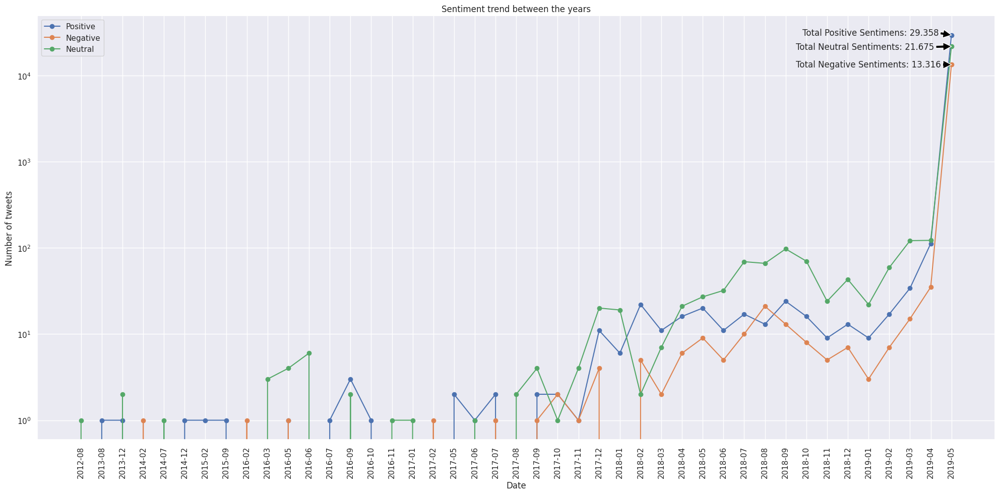

In [0]:
#plot the sentiments trend in the entire period of the dataset

sns.set_theme()
plt.figure(figsize=(20, 10))
plt.title("Sentiment trend between the years")
plt.plot(pandas_trend["date"], pandas_trend["positive_sentiments"], label="Positive", marker="o")
plt.plot(pandas_trend["date"], pandas_trend["negative_sentiments"], label="Negative", marker="o")
plt.plot(pandas_trend["date"], pandas_trend["neutral_sentiments"], label="Neutral", marker="o")
plt.yscale("log")
plt.xticks(rotation=90)
plt.xlabel("Date")
plt.ylabel("Number of tweets")
plt.annotate("Total Positive Sentimens: 29.358", xy=("2019-05", 29358), xytext=(34.8, 29000), arrowprops=dict(facecolor="black"))
plt.annotate("Total Neutral Sentiments: 21.675", xy=("2019-05", 21675), xytext=(34.5, 20000), arrowprops=dict(facecolor="black"))
plt.annotate("Total Negative Sentiments: 13.316", xy=("2019-05", 13316), xytext=(34.5, 12500), arrowprops=dict(facecolor="black"))
plt.legend()
plt.tight_layout()
plt.show()

In the graph above, we can observe a more linear trend during the period from 2012 to 2017, with some peaks and dips. However, the number of tweets during this period is in the order of single digits, too few to draw significant conclusions. The first notable peak occurs in December 2017 and includes tweets of all kinds, which coincides with an increase in the value of Bitcoin (as seen in the last graph below). This increase might have generated more opinions in general from people interested in the world of cryptocurrencies, without a clear stance for or against them, which would explain the rise in neutral sentiment tweets. Similarly, it could have generated positive sentiment among those who owned Bitcoin or had anticipated the price increase. Negative sentiment may have been observed among those who predicted or believed the price would drop instead of rising.

Afterward, the situation remained fluctuating but in the range of tens of tweets per month. The real surge occurred in 2019, which is more clearly visible in the graph below.

# **Monthly Sentiment Variation in 2019**

In [0]:
trend_df.createOrReplaceTempView("splitting_2019")

In [0]:
#take the part of the dataframe related to year 2019

trend_df_2019=spark.sql("""                   
select 
substr(cast(timestamp as string), 1, 7) as date,
count(case when sentiment is not null then 1 else null end) as total_sentiments,
sum(case when sentiment="Positive" then 1 else 0 end) as positive_sentiments,
sum(case when sentiment="Negative" then 1 else 0 end) as negative_sentiments,
sum(case when sentiment="Neutral" then 1 else 0 end) as neutral_sentiments
from splitting
where year(timestamp)==2019
group by 1
order by date 
""")

In [0]:
display(trend_df_2019)

date,total_sentiments,positive_sentiments,negative_sentiments,neutral_sentiments
2019-01,34,9,3,22
2019-02,83,17,7,59
2019-03,170,34,15,121
2019-04,269,112,35,122
2019-05,64349,29358,13316,21675


In [0]:
#convert spark df in a pandas df to have an higher compatibility with matplotlib

pandas_trend_2019= ps.DataFrame(trend_df_2019)

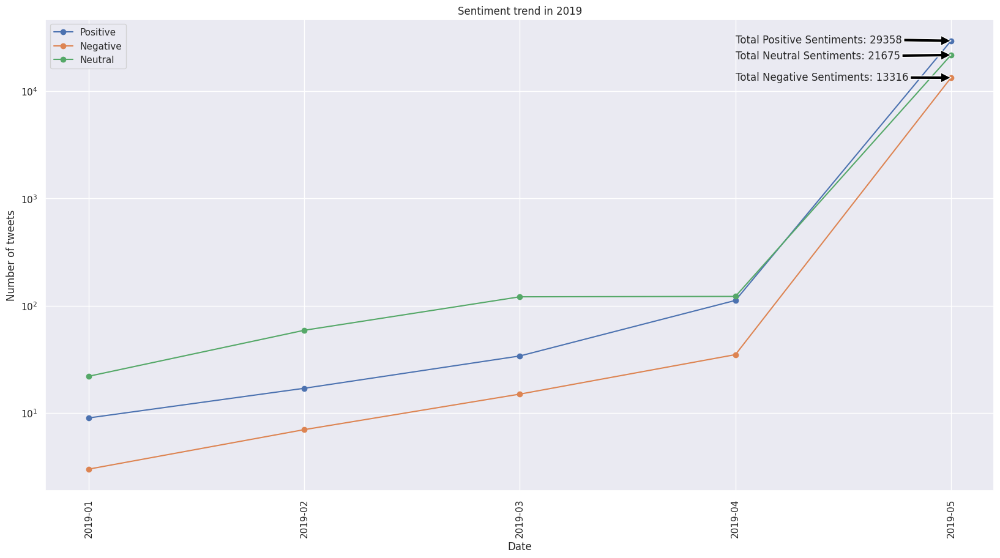

In [0]:
#plot the sentiments trend only in 2019

plt.figure(figsize=(20, 10))
plt.title("Sentiment trend in 2019")
plt.plot(pandas_trend_2019["date"], pandas_trend_2019["positive_sentiments"], label="Positive", marker="o")
plt.plot(pandas_trend_2019["date"], pandas_trend_2019["negative_sentiments"], label="Negative", marker="o")
plt.plot(pandas_trend_2019["date"], pandas_trend_2019["neutral_sentiments"], label="Neutral", marker="o")
plt.yscale("log")
plt.xticks(rotation=90)
plt.xlabel("Date")
plt.ylabel("Number of tweets")
plt.annotate("Total Positive Sentiments: 29358", xy=("2019-05", 29358), xytext=(3, 28000), arrowprops=dict(facecolor="black"))
plt.annotate("Total Neutral Sentiments: 21675", xy=("2019-05", 21675), xytext=(3, 20000), arrowprops=dict(facecolor="black"))
plt.annotate("Total Negative Sentiments: 13316", xy=("2019-05", 13316), xytext=(3, 12500), arrowprops=dict(facecolor="black"))
plt.legend()
plt.show()

As can be seen, between April and May 2019, there was an exponential increase in the number of tweets across all categories. This coincides with a significant increase in the value of Bitcoin, as shown in the graph below. Additionally, it is also clear that in May 2019, the price began to rise, reaching its peak in July 2017. Most likely, if we had data beyond May 2019, we would have observed a possible increase in positive sentiment, correlated with the rise in Bitcoin’s value.

# **Relationship between Sentiment Variation and Bitcoin Price Value**

In [0]:
#read the table

btc_trend= spark.table("btc_usd").select("Date", "Close")

In [0]:
btc_trend.createOrReplaceTempView("btc_trend")

In [0]:
#the table contains the daily closing price of Bitcoin. In this cell, the table has been grouped by month, and the average Bitcoin price has been calculated for each month. Then, only the records within the annual range from 2014 to 2019 were selected, as this is the reference period in the sentiment dataset.

btc_price=spark.sql("""select
substr(Date, 1, 7) as date,
avg(Close) as Mean_Close
from btc_trend
where year(timestamp(Date)) between 2014 and 2019
group by 1
order by 1""")

In [0]:
#convert spark DataFrame into a pandas DataFrame in order to have a better compatibility with matplotlib

btc_price= ps.DataFrame(btc_price)

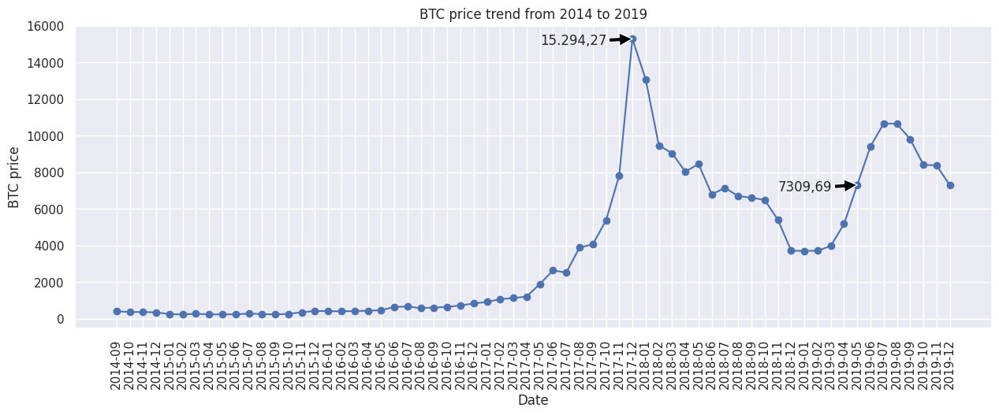

In [0]:
#plot the price trend of bitcoin between 2014 and 2019

plt.figure(figsize=(15, 5))
plt.title("BTC price trend from 2014 to 2019")
plt.plot(btc_price["date"], btc_price["Mean_Close"], marker="o")
plt.xlabel("Date")
plt.ylabel("BTC price")
plt.annotate("15.294,27", xy=("2017-12", 15294), xytext=(32, 15000), arrowprops=dict(facecolor="black"))
plt.annotate("7309,69", xy=("2019-05", 7309), xytext=(50, 7000), arrowprops=dict(facecolor="black"))
plt.xticks(rotation=90)
plt.show()

# **Engagement Generated by Tweets**


In this final part of the project, the engagement generated by tweets was analyzed. The average number of likes and replies was compared between tweets with positive and negative sentiment. 

In [0]:
#select only columns useful for the analysis

eng_df= sentiment_df.select("replies", "likes", "sentiment")

In [0]:
eng_df.createOrReplaceTempView("engagement")

In [0]:
#get the total number of likes for each sentiment and principal descriptive statistics

tot_likes=spark.sql("""select
sentiment,
count(case when likes<> 0 then 1 else null end) as count,
sum(case when likes <> 0 then likes else 0 end) as sum,
round(avg(likes), 2) as mean,
round(std(likes), 2) as standard_deviation
from engagement
where sentiment in ("Positive", "Negative")
group by 1""")
display(tot_likes)

sentiment,count,sum,mean,standard_deviation
Positive,4282,250539.0,8.42,80.44
Negative,1980,112976.0,8.38,83.02


In [0]:
#get the total number of replies for each sentiment and principal descriptive statistics

tot_replies=spark.sql("""select
sentiment,
count(case when replies<> 0 then 1 else null end) as count,
sum(case when replies <>0 then replies else 0 end) as sum,
round(avg(replies), 2) as mean,
round(std(replies), 2) as standard_deviation
from engagement
where sentiment in ("Positive", "Negative")
group by 1""")
display(tot_replies)

sentiment,count,sum,mean,standard_deviation
Positive,2339,28659.0,0.96,11.7
Negative,1157,12755.0,0.95,10.55


As observed in the tables above, there are no significant differences in the average number of likes and replies between tweets with positive sentiment and tweets with negative sentiment.

On average, tweets receive 8 likes and 1 reply.